In [1]:
from __future__ import (absolute_import, division,
                        print_function, unicode_literals)

import warnings
warnings.simplefilter('ignore')

# general purpose packages
import pandas as pd
import numpy as np
import os
import json
import time
import re
import csv
import subprocess
import sys
import itertools

import scipy.stats as stats
import statsmodels.stats as smstats
import statsmodels.api as sm
from statsmodels.stats.multitest import multipletests

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.decomposition import KernelPCA

# for anomaly detection
from sklearn.ensemble import IsolationForest
import jenkspy

import umap
import rpy2

from multiprocessing import Process, Manager, Pool
import multiprocessing
from functools import partial

from collections import Counter

import seaborn as sns; sns.set()

import matplotlib
matplotlib.style.use('seaborn')
matplotlib.use('Agg')
import matplotlib.pyplot as plt
matplotlib.rcParams['backend'] = "Qt5Agg"
import matplotlib.ticker as ticker
from matplotlib.ticker import FuncFormatter

from matplotlib.patches import Patch
from matplotlib.lines import Line2D

from IPython.display import display, Image

from adjustText import adjust_text
import builtins
%matplotlib inline

import textwrap

# for normalization
from sklearn.linear_model import QuantileRegressor

# for custom clustering
from scipy.cluster.hierarchy import linkage
from scipy.spatial.distance import squareform
from matplotlib.patches import Rectangle

# for selecting combinations
from itertools import combinations

# for working with yaml files
import ruamel.yaml

In [2]:
def get_pvalue_star(pval, thr=0.05):
    if thr == 0.05:
        if pval < 0.001:
            return "***"
        elif pval < 0.01:
            return "**"
        elif pval < 0.05:
            return "*"
        else:
            return "ns"
    elif thr == 0.1:
        if pval < 0.001:
            return "***"
        elif pval < 0.01:
            return "**"
        elif pval < 0.1:
            return "*"
        else:
            return "ns"

In [3]:
# paths to subdirectories
subdirs = {}

# shared project folder
subdirs['shared_project_dir'] = '/scicore/home/zavolan/GROUP/StefanieCLIP/aleksei/'

subdirs['temp_dir'] = subdirs['shared_project_dir']+'temp_dir/'
subdirs['slurm_dir'] = subdirs['temp_dir']+'slurm/'
subdirs['scripts_dir'] = subdirs['shared_project_dir']+'scripts/'
subdirs['reports_dir'] = subdirs['shared_project_dir']+'reports/'

# path to WF results
subdirs['results'] = subdirs['shared_project_dir']+'output/'

# paths to files
file_paths = {}

### metadata input samples
file_paths['input_samples'] = subdirs['shared_project_dir']+'metadata/start_samples.tsv'

os.system('mkdir -p '+' '.join(list(subdirs.values()))) # create all subdirs

### we can exclude some samples
samples_to_exclude_from_analysis = []

# Collect metadata for all samples and define colors for plots 

In [4]:
input_samples = pd.read_csv(file_paths['input_samples'],delimiter="\t",index_col=None,header=0)
input_samples = input_samples.rename(columns={'name':'sample'})
input_samples = input_samples.loc[~input_samples['sample'].isin(samples_to_exclude_from_analysis)].reset_index(drop=True)

metadata = input_samples.copy()
metadata['group_1'] = metadata.apply(lambda x: x['lane_name'] if x['kmer']=='NNNN' else x['batch'],1)
metadata['group_2'] = metadata['exp_ctl'] # group_1 x group_2 are used to block into subplots, and group_3 is on the x axis + color
metadata['group_3'] = metadata['condition_name']
group_1_order = ['f230802','f230126','f230117','f20220722','f220407','f2533F1','f2161F1','f2143F1','public_bCLIP_mESC','public_eCLIP_Hela']
group_2_order = ['exp','neg_ctl','ctl']
group_3_order = ['Ints11C','Ints11N','Ints10C','Ints10N','Ints1N','Ints11','NRDE2','Nrde2_D174Rmut','NRDE2_200AANenddel','HP1','RBC','XRN1','N4BP2C','Ccdc174','Eif4a3','Mtrex','Ints11_SMInput','Igg']

color_list = ['orange','gold','green','lime','violet','purple','blue','royalblue','cyan','grey','grey','grey','grey','grey','grey','grey','grey','grey']

metadata = pd.merge(metadata,pd.DataFrame([group_3_order,color_list]).transpose().rename(columns={0:'group_3',1:'color'}),how='inner',on='group_3')
metadata['group_1_x_group_2'] = metadata['group_1']+'-'+metadata['group_2']

gr = metadata[['group_1','group_2','group_3']].drop_duplicates().reset_index(drop=True)
gr['t']=1
gr = gr.groupby(['group_1','group_2']).agg({'t':sum}).reset_index()
tmp = gr[['group_1','group_2']].values.tolist()

point_plots_width_ratios = []
group_1_x_group_2 = []
for element in itertools.product(*[group_1_order,group_2_order]):
    if list(element) in tmp:
        group_1_x_group_2.append(list(element))
        point_plots_width_ratios.append(gr.loc[(gr['group_1']==element[0])&(gr['group_2']==element[1])].iloc[0]['t'])
        
metadata['replicate'] = metadata.apply(lambda x: x['sample'] if x['batch'] not in ['public_bCLIP_mESC','public_eCLIP_Hela'] else x['condition_name']+'_'+x['sample'][-3:],1)

# Plotting settings

In [7]:
major_text_size = 15
rotation_degree = 45
alpha_param=1

sns.set(font_scale=1)
sns.set_style("white")

# fastqc

In [8]:
### Functions for parsing fastqc reports

def get_total_sequences(fastqc_data_text):
    for s in fastqc_data_text:
        if s.startswith('Total Sequences\t'):
            return int(s.split('\t')[1])
    return None

def get_Per_base_sequence_quality(fastqc_data_text):
    started = False
    finished = False
    a = []
    for s in fastqc_data_text:
        if s.startswith('>>Per base sequence quality'):
            started=True
            continue
        if started:
            if s.startswith('#Base\tMean\tMedian\t'):
                header = s.replace('\n','').split('\t')
            elif s.startswith('>>END_MODULE'):
                finished = True
                break
            else:
                a.append(s.replace('\n',''))
    df = pd.DataFrame(a)[0].str.split('\t',expand=True)
    df.columns = header
    return df

def get_drop_Per_base_sequence_quality(df):
    exclude_first_N_nt = 5
    df = df.tail(len(df)-exclude_first_N_nt)
    l = len(df)
    first_half = df.head(int(l/2))['Median'].median()
    last_half = df.tail(int(l/2))['Median'].median()
    return (last_half+1)/(first_half+1)

def get_Per_sequence_GC_content_flag(fastqc_data_text):
    for s in fastqc_data_text:
        if s.startswith('>>Per sequence GC content'):
            return s.split('\t')[1].replace('\n','')
    return None

def get_Sequence_Length_Distribution(fastqc_data_text):
    started = False
    finished = False
    a = []
    for s in fastqc_data_text:
        if s.startswith('>>Sequence Length Distribution'):
            started=True
            continue
        if started:
            if s.startswith('#Length'):
                header = s.replace('\n','').split('\t')
            elif s.startswith('>>END_MODULE'):
                finished = True
                break
            else:
                a.append(s.replace('\n',''))
    df = pd.DataFrame(a)[0].str.split('\t',expand=True)
    df.columns = header
    return df

def get_kth_stat_from_hist_df(input_histogram_df,kth):
    input_histogram_df.columns = ['value','count']
    input_histogram_df['count'] = input_histogram_df['count'].astype('float')
    input_histogram_df['frac'] = input_histogram_df['count']/input_histogram_df['count'].sum()
    input_histogram_df = input_histogram_df[['value','frac']]
    # esstimate iqr and median
    kth_stat_val = None
    skip=False
    cum_frac = 0
    for elem in input_histogram_df.values:
        cum_frac = cum_frac+elem[1]
        if cum_frac>=kth and kth_stat_val==None:
            kth_stat_val = elem[0]
            break
    return kth_stat_val

def get_Sequence_Duplication_Levels(fastqc_data_text):
    started = False
    finished = False
    skip_one = False
    a = []
    for s in fastqc_data_text:
        if skip_one:
            skip_one = False
            continue
        if s.startswith('>>Sequence Duplication Levels'):
            started=True
            skip_one=True
            continue
        if started:
            if s.startswith('#Duplication Level'):
                header = s.replace('\n','').split('\t')
            elif s.startswith('>>END_MODULE'):
                finished = True
                break
            else:
                a.append(s.replace('\n',''))
    df = pd.DataFrame(a)[0].str.split('\t',expand=True)
    df.columns = header
    return df

def get_frac_of_seq_dupl(seq_dupl_df,dupl_level):
    seq_dupl_df.columns = ['Duplication_Level','Percentage_of_total']
    seq_dupl_df['Percentage_of_total'] = seq_dupl_df['Percentage_of_total'].astype('float')
    seq_dupl_df['frac'] = seq_dupl_df['Percentage_of_total']/seq_dupl_df['Percentage_of_total'].sum()
    target_pos = int(seq_dupl_df.loc[seq_dupl_df['Duplication_Level']==dupl_level].index[0])
    perc_of_seq_dupl = seq_dupl_df.tail(len(seq_dupl_df)-target_pos)['frac'].sum()
    return perc_of_seq_dupl

def get_per_base_sequence_content(fastqc_data_text):
    started = False
    finished = False
    a = []
    for s in fastqc_data_text:
        if s.startswith('>>Per base sequence content'):
            started=True
            continue
        if started:
            if s.startswith('#Base'):
                header = s.replace('\n','').split('\t')
            elif s.startswith('>>END_MODULE'):
                finished = True
                break
            else:
                a.append(s.replace('\n',''))
    df = pd.DataFrame(a)[0].str.split('\t',expand=True)
    df.columns = header
    return df

def get_nucl_stretch_length(sequence_content_table,nucleotide,perc_thr):
    sel = sequence_content_table.loc[sequence_content_table[nucleotide].astype('float')>perc_thr]
    if len(sel)==0:
        cur = list(sequence_content_table['#Base'])[-1].split('-')
        return 0,(int(cur[0]) if len(cur)==1 else int(cur[1]))
    
    ungrouped_positions = []
    for elem in list(sel['#Base']):
        cur = elem.split('-')
        if len(cur)==1:
            ungrouped_positions = ungrouped_positions+[int(cur[0])]
        else:
            ungrouped_positions = ungrouped_positions+[int(cur[0]),int(cur[1])]

    # find longest stretch
    breaked = True
    prev = None
    ls = [] # list of stretches and positions
    cur_ls = 0
    i = 0
    for elem in ungrouped_positions:
        if prev!=None and elem!=(prev+1):
            ls.append([cur_ls,elem-cur_ls])
            cur_ls = 1
            prev = elem
        else:
            cur_ls = cur_ls+1
            prev = elem
        i=i+1
        if i==len(ungrouped_positions):
            ls.append([cur_ls,elem-cur_ls])
    ls = pd.DataFrame(ls)
    res = ls.loc[ls[0]==max(ls[0])].iloc[0]
    return res[0],res[1]

def get_parsed_fastqc(fastqc_data_file_path):
    fastqc_data_text = ''
    f = open(fastqc_data_file_path,'r')
    fastqc_data_text = f.readlines()
    f.close()
    if (fastqc_data_text is None) or (fastqc_data_text==''):
        return None
    parsed = {}
    
    parsed['Total_Sequences_number'] = get_total_sequences(fastqc_data_text)
    
    parsed['Per_base_sequence_quality_table'] = get_Per_base_sequence_quality(fastqc_data_text)
    parsed['median_Per_base_sequence_quality'] = parsed['Per_base_sequence_quality_table']['Median'].median()
    parsed['mean_Per_base_sequence_quality'] = parsed['Per_base_sequence_quality_table']['Mean'].median()
    parsed['drop_Per_base_sequence_quality'] = get_drop_Per_base_sequence_quality(parsed['Per_base_sequence_quality_table'])
    
    parsed['Per_sequence_GC_content_flag'] = get_Per_sequence_GC_content_flag(fastqc_data_text)
    
    parsed['Sequence_Length_Distribution_table'] = get_Sequence_Length_Distribution(fastqc_data_text)
    parsed['Sequence_Length_10percQuant'] = get_kth_stat_from_hist_df(parsed['Sequence_Length_Distribution_table'].copy(),0.1)
    parsed['Sequence_Length_50percQuant'] = get_kth_stat_from_hist_df(parsed['Sequence_Length_Distribution_table'].copy(),0.5)
    parsed['Sequence_Length_90percQuant'] = get_kth_stat_from_hist_df(parsed['Sequence_Length_Distribution_table'].copy(),0.9)
    
    parsed['Sequence_Duplication_Levels_table'] = get_Sequence_Duplication_Levels(fastqc_data_text)
    parsed['more_10_dupl'] = get_frac_of_seq_dupl(parsed['Sequence_Duplication_Levels_table'].copy(),'>10')
    parsed['more_100_dupl'] = get_frac_of_seq_dupl(parsed['Sequence_Duplication_Levels_table'].copy(),'>100')
    parsed['more_1k_dupl'] = get_frac_of_seq_dupl(parsed['Sequence_Duplication_Levels_table'].copy(),'>1k')
    parsed['more_10k_dupl'] = get_frac_of_seq_dupl(parsed['Sequence_Duplication_Levels_table'].copy(),'>10k+')
    
    parsed['sequence_content_table'] = get_per_base_sequence_content(fastqc_data_text)
    parsed['A_content'] = parsed['sequence_content_table']['A'].astype('float').quantile(q=0.5)
    parsed['A_stretch_length'],parsed['A_stretch_start_pos'] = get_nucl_stretch_length(parsed['sequence_content_table'].copy(),'A',40)
    parsed['T_content'] = parsed['sequence_content_table']['T'].astype('float').quantile(q=0.5)
    parsed['T_stretch_length'],parsed['T_stretch_start_pos'] = get_nucl_stretch_length(parsed['sequence_content_table'].copy(),'T',40)
    parsed['C_content'] = parsed['sequence_content_table']['C'].astype('float').quantile(q=0.5)
    parsed['C_stretch_length'],parsed['C_stretch_start_pos'] = get_nucl_stretch_length(parsed['sequence_content_table'].copy(),'C',40)
    parsed['G_content'] = parsed['sequence_content_table']['G'].astype('float').quantile(q=0.5)
    parsed['G_stretch_length'],parsed['G_stretch_start_pos'] = get_nucl_stretch_length(parsed['sequence_content_table'].copy(),'G',40)
    
    return parsed

# Categorization of mapped reads

In [32]:
def get_class_label(class_name,dupl_cats_dict):
    mm_cat = class_name.split(';')[0]
    mm_cat = ('uniquely mapped' if mm_cat=='uniquely_mapped' else mm_cat)
    dupl_level = dupl_cats_dict[int(class_name.split(';')[1])]
    return mm_cat+'\n'+dupl_level+' dups'
    
dupl_cats_dict = {0:'1-10',1:'10-100',2:'100-1k',3:'1k-10k',4:'10k-100k',5:'100k-1mln'}
multi_mapped_cats = ['uniquely_mapped','multimapped']

tmp1 = pd.DataFrame(dupl_cats_dict.keys(),columns=['dupl_cat'])
tmp1['t']=1
tmp2 = pd.DataFrame(multi_mapped_cats,columns=['mm_cat'])
tmp2['t']=1
tmp = pd.merge(tmp1,tmp2,how='inner',on='t')
tmp['count_col'] = tmp['mm_cat']+';'+tmp['dupl_cat'].astype('str')
count_cols_df = tmp.copy()
count_cols = list(count_cols_df['count_col'])

## Detailed analysis of mapping patterns in different read categories

In [9]:
def get_processed_cigar_stats(sel_cigar_stats_table):

    sel_cigar_stats_table = sel_cigar_stats_table.loc[(~sel_cigar_stats_table['cigar'].str.contains('|'.join(['D','I','H','P'])))].reset_index(drop=True) # remove reads with deletions or insertions
    
    sel_cigar_stats_table['cigar'] = sel_cigar_stats_table['cigar'].str.replace('[0-9]+N','',regex=True)
    
    def get_map_start_Base(x):
        s = x['cigar'].split('S')[0]
        if 'M' in s:
            return 1
        else:
            return int(s)+1
    sel_cigar_stats_table['map_start_Base'] = sel_cigar_stats_table.apply(lambda x:get_map_start_Base(x),1)
    
    reg_expr = re.compile('[0-9]+')
    def get_map_end_Base(x,reg_expr):
        return sum([sum([int(elem1) for elem1 in re.findall(reg_expr, elem)]) for elem in x['cigar'].split('M')[:-1]])
    sel_cigar_stats_table['map_end_Base'] = sel_cigar_stats_table.apply(lambda x:get_map_end_Base(x,reg_expr),1)
    
    def get_snp_bases(x):
        s = x['MD']
        l = re.split('[A-Z]',s)
        positions = []
        if len(l)>1:
            pred = 0
            for elem in l[:-1]:
                if elem=='':
                    shift = 1
                else:
                    shift = int(elem)+1
                positions.append(pred+shift)
                pred = pred+shift
        return positions
    
    sel_cigar_stats_table['snp_bases'] = sel_cigar_stats_table.apply(lambda x:get_snp_bases(x),1)
    
    start_base_df = sel_cigar_stats_table.groupby('map_start_Base').agg({'w':sum}).reset_index().sort_values('map_start_Base').reset_index(drop=True)
    start_base_df['%'] = start_base_df['w']/start_base_df['w'].sum()*100
    
    end_base_df = sel_cigar_stats_table.groupby('map_end_Base').agg({'w':sum}).reset_index().sort_values('map_end_Base').reset_index(drop=True)
    end_base_df['%'] = end_base_df['w']/end_base_df['w'].sum()*100
    
    a = []
    for elem in sel_cigar_stats_table.loc[sel_cigar_stats_table['snp_bases'].astype('str')!='[]'][['snp_bases','w']].values:
        for elem1 in elem[0]:
            a.append([elem1,elem[1]])
    snp_base_df = pd.DataFrame(a,columns = ['snp_Base','w']).groupby('snp_Base').agg({'w':sum}).reset_index().sort_values('snp_Base').reset_index(drop=True)
    snp_base_df['%'] = snp_base_df['w']/sel_cigar_stats_table['w'].sum()*100

    return start_base_df,end_base_df,snp_base_df

In [27]:
suffix = '_fastqc.zip'
sample_file_name = subdirs['temp_dir']+'fastqc_file_paths.tsv'
os.system("""find """+subdirs['results']+'samples/'+""" -name '*"""+suffix+"""' > """+sample_file_name)
fastqc_file_paths = pd.read_csv(sample_file_name,delimiter="\t",
                                   index_col=None,header=None)
fastqc_file_paths.columns = ['path']
fastqc_file_paths = fastqc_file_paths.loc[(fastqc_file_paths['path'].str.contains('map_genome_long'))&(fastqc_file_paths['path'].str.contains('read_categories'))].reset_index(drop=True)
for index, row in fastqc_file_paths.iterrows():
    output_dir = os.path.dirname(row['path'])+'/unzipped/'
    out = subprocess.check_output('unzip -o -d '+output_dir+' '+row['path'], shell=True)
fastqc_file_paths['fastqc_data_path'] = fastqc_file_paths.apply(lambda x:os.path.dirname(x['path'])+'/unzipped/'+os.path.basename(x['path']).replace('.zip','')+'/fastqc_data.txt',1)
fastqc_file_paths['sample.read_category'] = fastqc_file_paths.apply(lambda x:os.path.basename(x['path']).replace(suffix,''),1)
fastqc_file_paths['sample'] = fastqc_file_paths['sample.read_category'].str.split('.',expand=True)[0]
fastqc_file_paths = fastqc_file_paths.loc[~fastqc_file_paths['sample'].isin(samples_to_exclude_from_analysis)].reset_index(drop=True)
fastqc_file_paths.to_csv(subdirs['temp_dir']+'read_category_fastqc_files.tsv', sep=str('\t'),header=True,index=None,quoting=csv.QUOTE_NONE)

In [28]:
suffix = '.cigar_stats.tsv'
sample_file_name = subdirs['temp_dir']+'cigar_stats_paths.tsv'
os.system("""find """+subdirs['results']+'samples/'+""" -name '*"""+suffix+"""' > """+sample_file_name)
cigar_stats_paths = pd.read_csv(sample_file_name,delimiter="\t",
                                   index_col=None,header=None)
cigar_stats_paths.columns = ['path']
cigar_stats_paths = cigar_stats_paths.loc[(cigar_stats_paths['path'].str.contains('map_genome_long'))&(cigar_stats_paths['path'].str.contains('read_categories'))].reset_index(drop=True)

cigar_stats_paths['sample.read_category'] = cigar_stats_paths.apply(lambda x:os.path.basename(x['path']).replace(suffix,''),1)
cigar_stats_paths['sample'] = cigar_stats_paths['sample.read_category'].str.split('.',expand=True)[0]
cigar_stats_paths = cigar_stats_paths.loc[~cigar_stats_paths['sample'].isin(samples_to_exclude_from_analysis)].reset_index(drop=True)
cigar_stats_paths['read_category'] = cigar_stats_paths['sample.read_category'].str.split('.',expand=True)[1]
cigar_stats_paths.to_csv(subdirs['temp_dir']+'cigar_stats_files.tsv', sep=str('\t'),header=True,index=None,quoting=csv.QUOTE_NONE)

In [30]:
# we may change to loading tsv file
read_category_fastqc_files = pd.read_csv(subdirs['temp_dir']+'read_category_fastqc_files.tsv',delimiter="\t",
                                   index_col=None,header=0)

In [ ]:
base_mapping_df

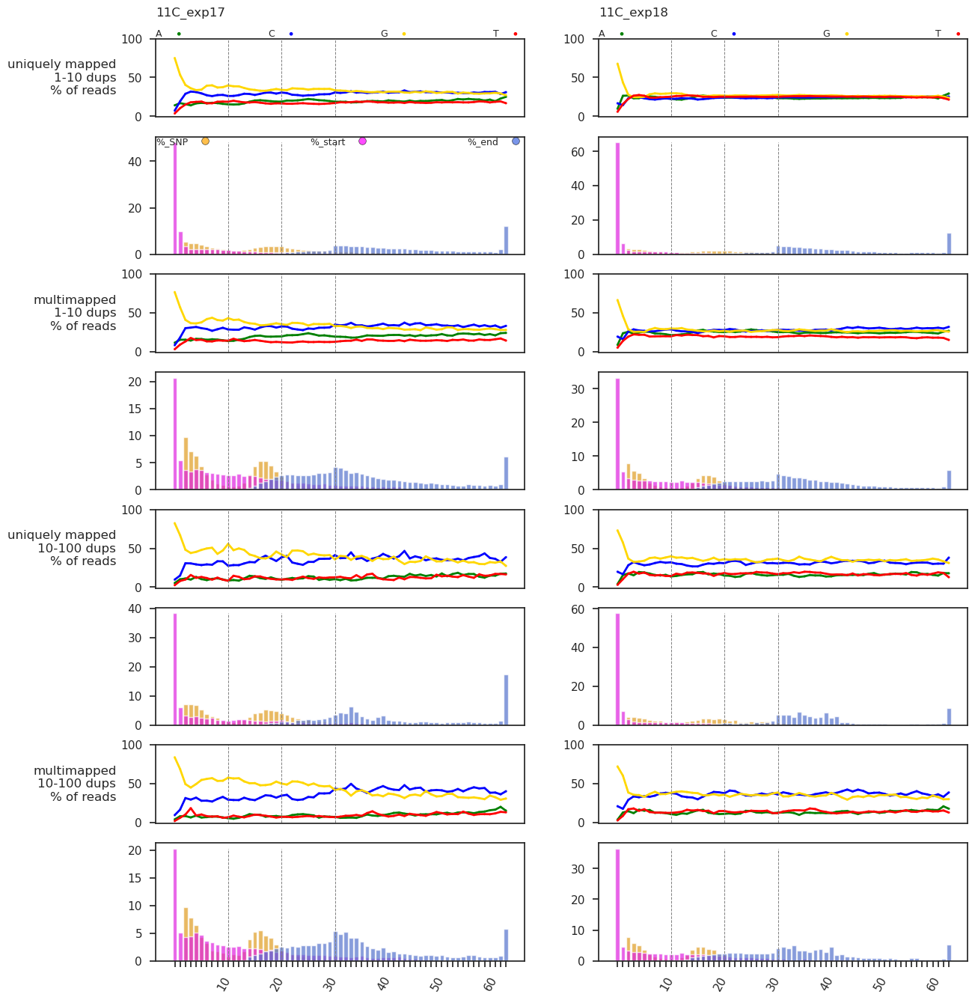

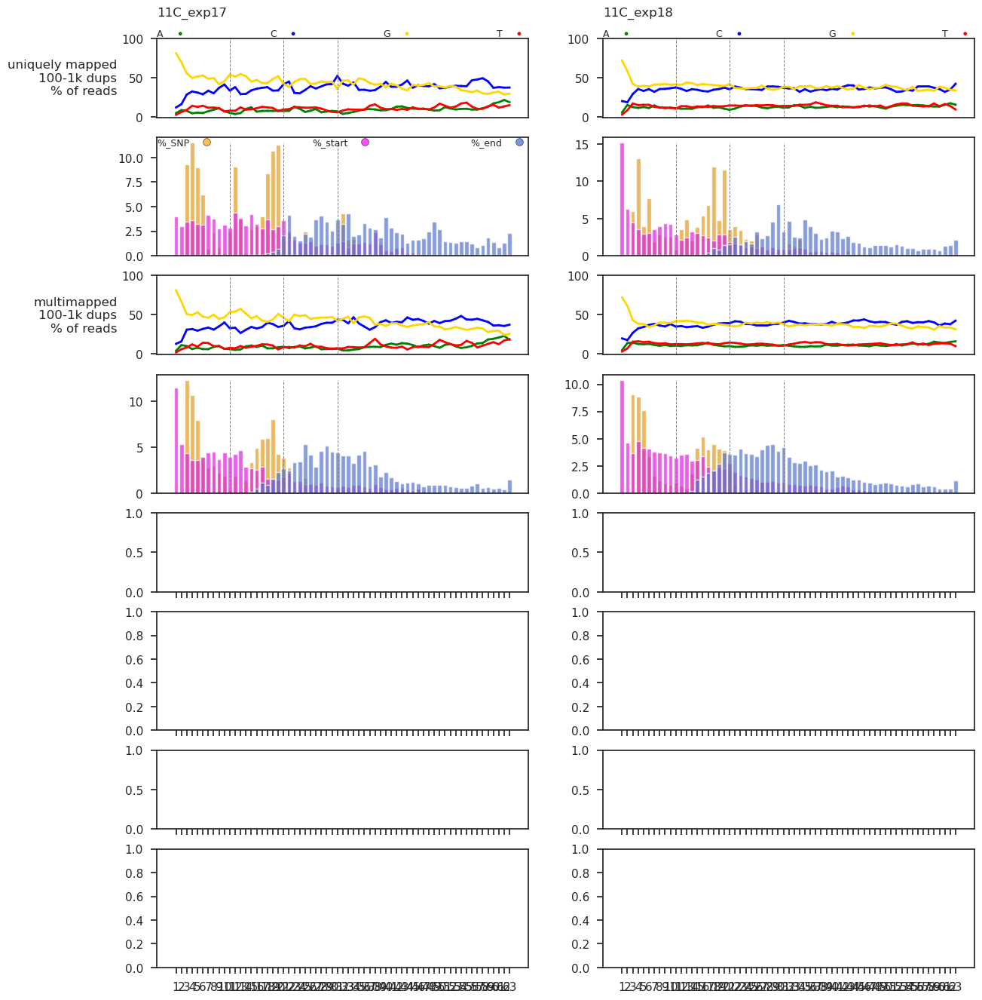

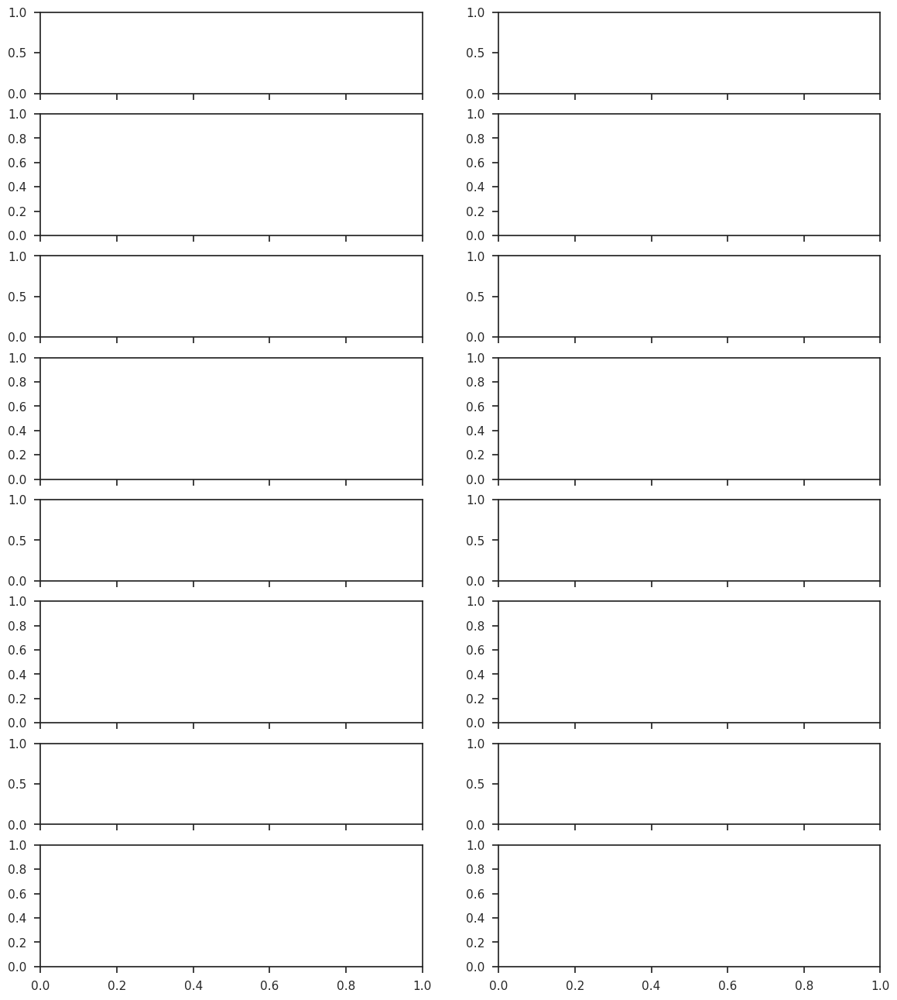

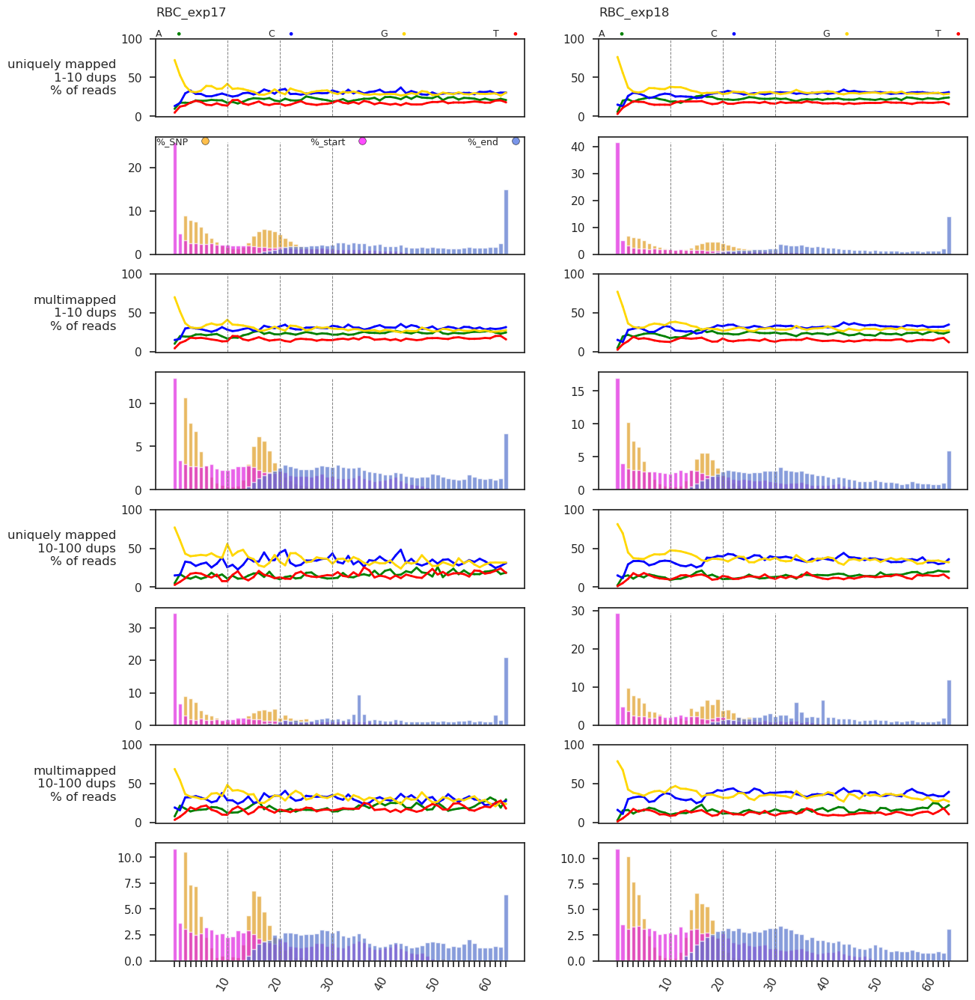

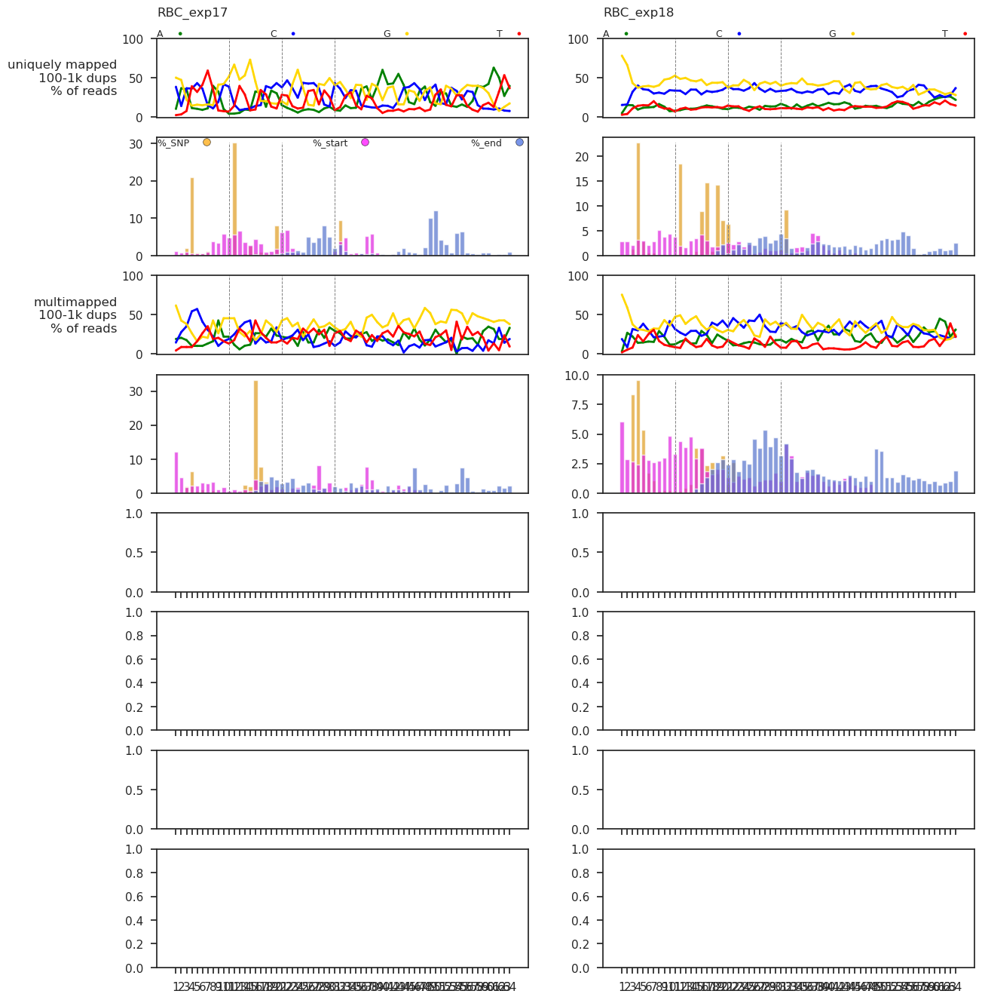

...

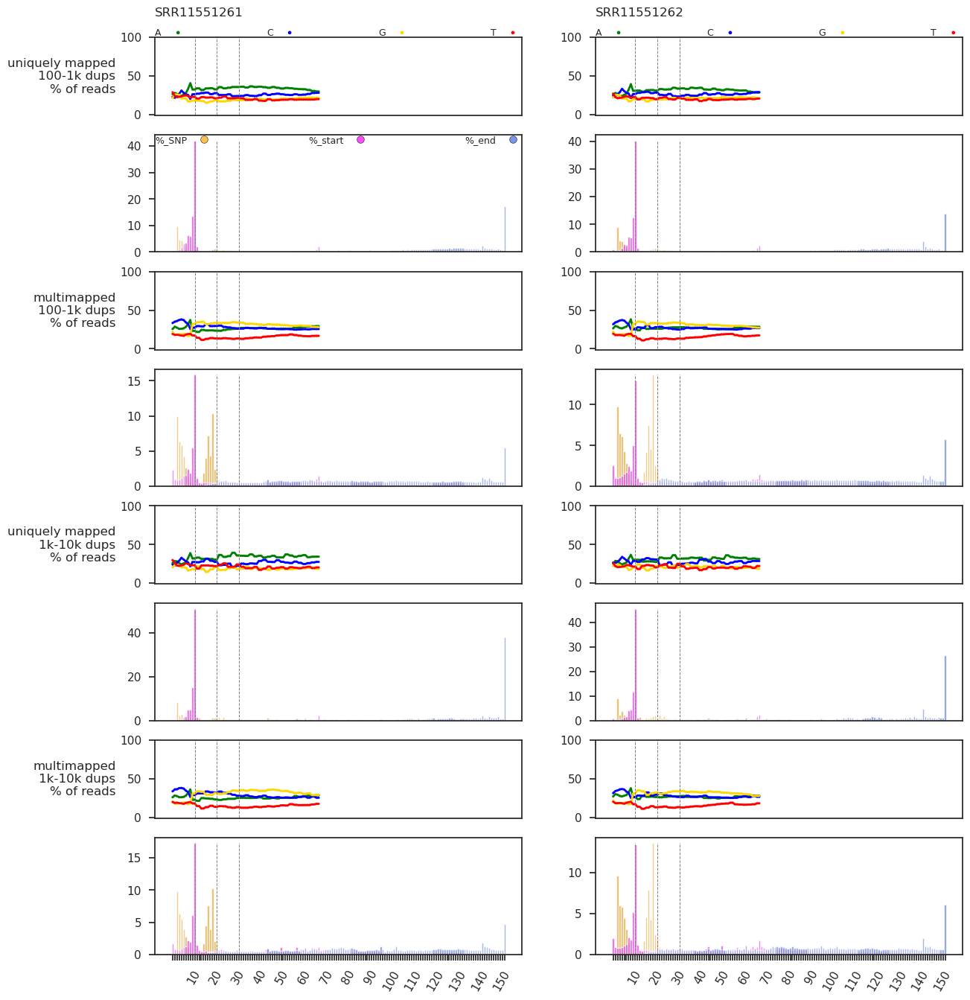

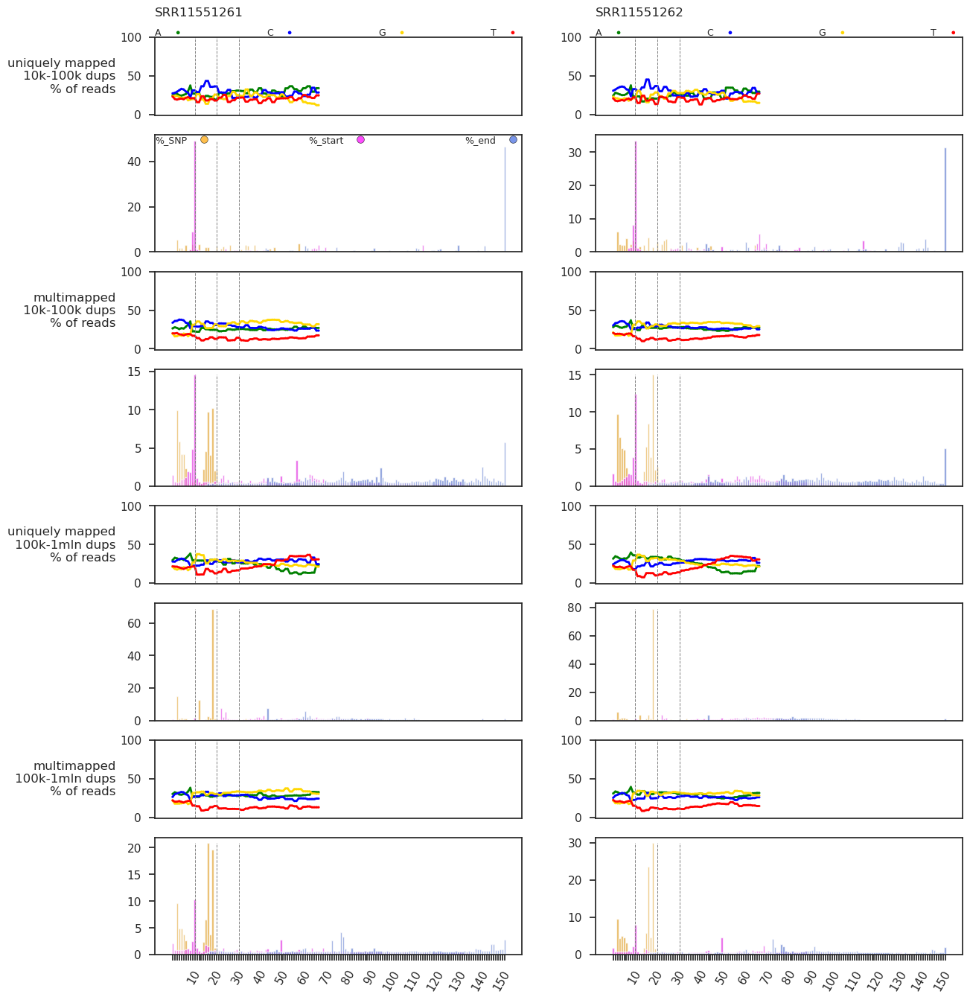

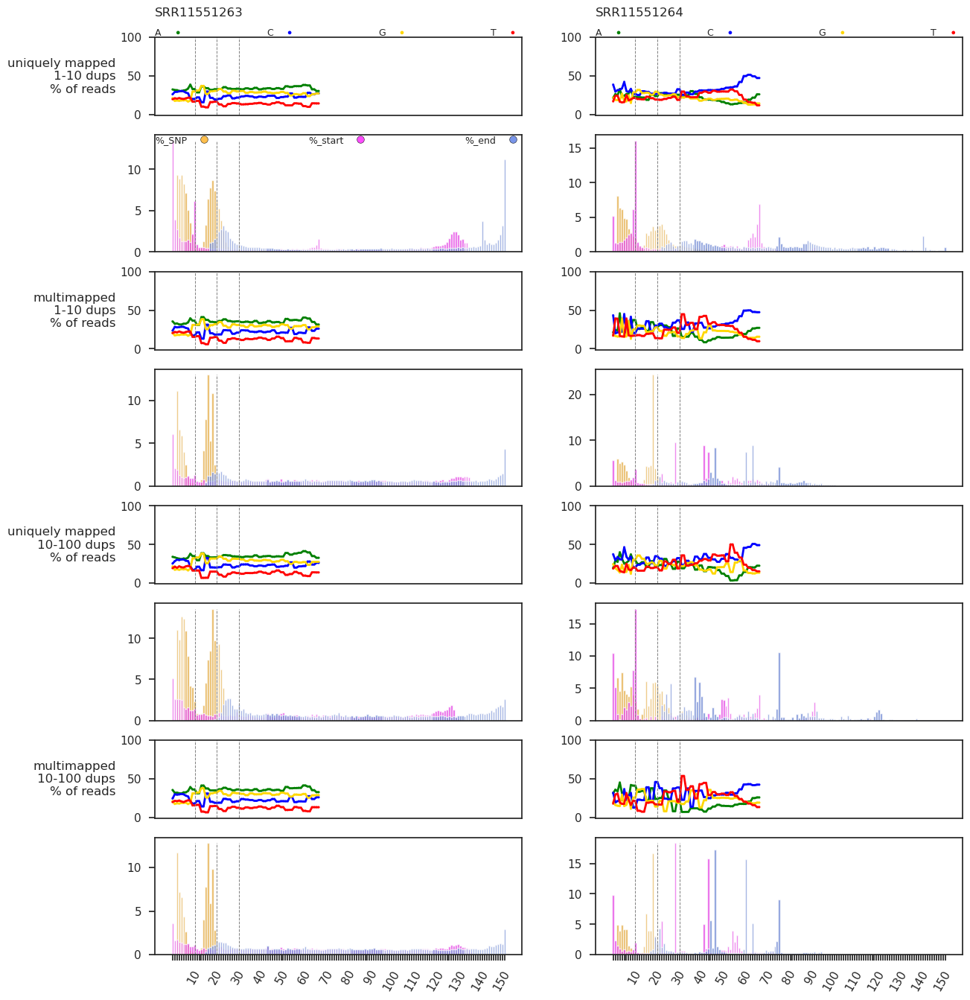

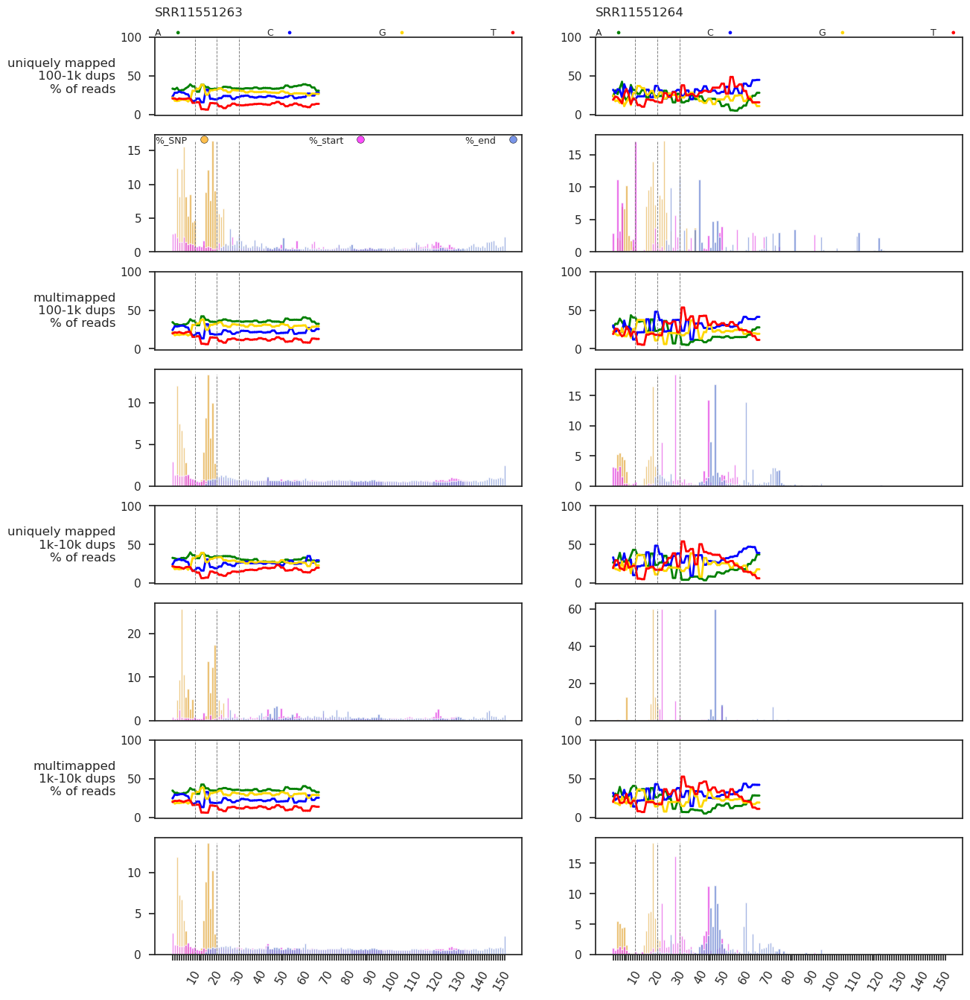

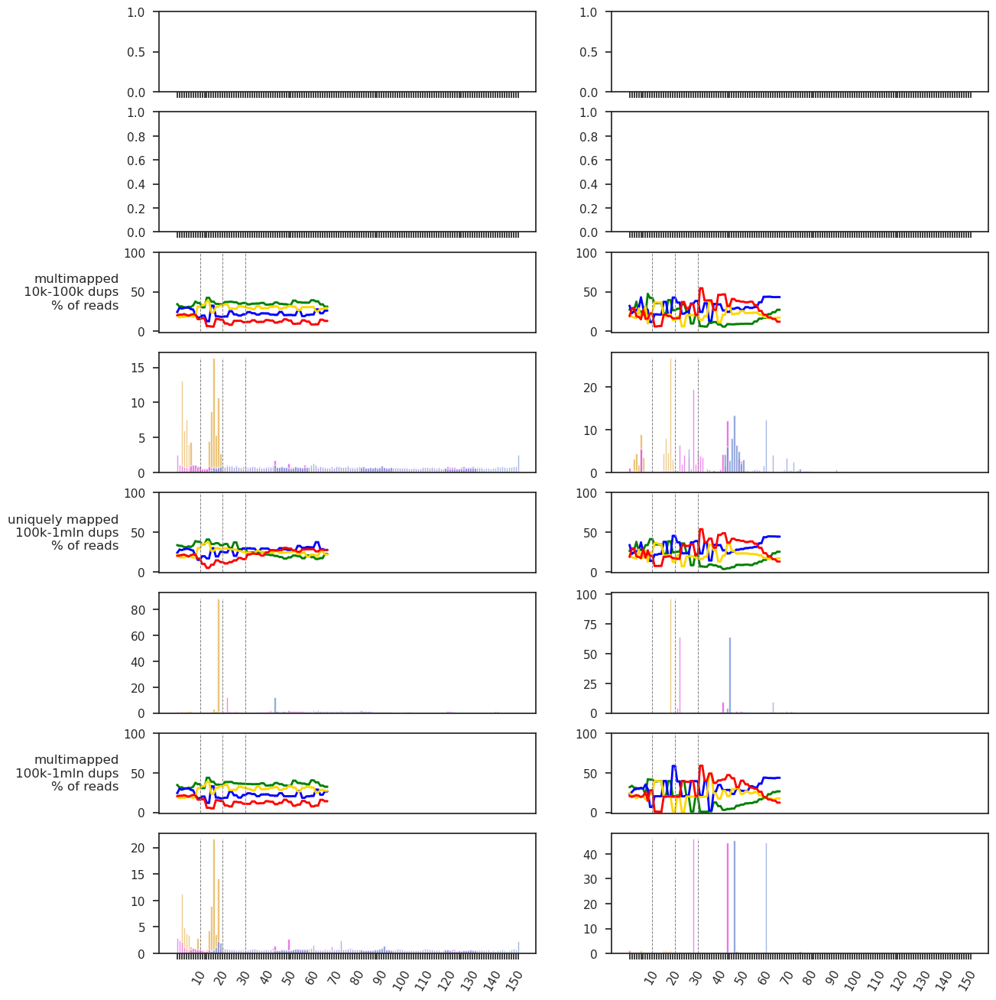

In [75]:
read_category_fastqc_files['read_category'] = read_category_fastqc_files['sample.read_category'].str.split('.',expand=True)[1]

subplot_height = 4

d_cats = [0,1,2,3,4,5]
mm_modes = ['um','mm']
vertical_lines = [10,20,30]

read_categories = list(itertools.product(*[d_cats,mm_modes])) # cartesian product

for subgroup in group_1_x_group_2:
    subgroup_label = '-'.join(list(subgroup))
    metadata_subgroup = metadata.loc[metadata['group_1_x_group_2']==subgroup_label].reset_index(drop=True)
    present_group_3_vals = list(metadata_subgroup['group_3'].unique())
    for group_3 in group_3_order:
        if group_3 in present_group_3_vals:
            for read_categories_subset in [read_categories[:4],read_categories[4:8],read_categories[8:]]:
                read_categories_subset_label = '_'.join(pd.Series(read_categories_subset[0]).astype('str'))+'-'+'_'.join(pd.Series(read_categories_subset[-1]).astype('str'))
                output_plot_path = subdirs['reports_dir']+'2_categorization_of_mapped_reads/detailed_mapping_analysis/'+subgroup_label+'/'+group_3+'.'+read_categories_subset_label+'.pdf'
                if (os.path.isfile(output_plot_path)) and (os.stat(output_plot_path).st_size > 0):
                    zzz=1
                    # continue
                out = subprocess.check_output('mkdir -p '+os.path.dirname(output_plot_path),shell=True)

                metadata_sub_subgroup = metadata_subgroup.loc[metadata_subgroup['group_3']==group_3].reset_index(drop=True)
                sample_list = list(metadata_sub_subgroup['sample'])

                plt.rcParams['xtick.bottom'] = True
                plt.rcParams['ytick.left'] = True
                
                height_ratios = [1,1.5]*len(read_categories_subset)
                fig, axes = plt.subplots(2*len(read_categories_subset),len(sample_list), sharey=False, sharex=True, 
                         figsize=(7*len(sample_list),subplot_height*len(read_categories_subset)),
                        gridspec_kw={'height_ratios': height_ratios})
                
                j=0
                for sample in sample_list:
                    i=0
                    for read_category in read_categories_subset:
                        read_category_label = '_'.join(pd.Series(read_category).astype('str'))
                        sel_fastq = read_category_fastqc_files.loc[(read_category_fastqc_files['sample']==sample)&(read_category_fastqc_files['read_category']==read_category_label)].copy()
                        if len(sel_fastq)==1:
                            # parse fastq output
                            parsed_fastqc_report = get_parsed_fastqc(sel_fastq.iloc[0]['fastqc_data_path'])
                            sequence_content_table = parsed_fastqc_report['sequence_content_table']
                            sequence_content_table['Base_1'] = sequence_content_table['#Base'].str.split('-',expand=True)[0]
                            sequence_content_table['Base_2'] = sequence_content_table['#Base'].str.split('-',expand=True).iloc[:, -1]
                            sequence_content_table = pd.concat([sequence_content_table[['Base_1','A','C','G','T']].rename(columns={'Base_1':'Base'}),
                            sequence_content_table[['Base_2','A','C','G','T']].rename(columns={'Base_2':'Base'})])
                            sequence_content_table = sequence_content_table.loc[~sequence_content_table['Base'].isna()].drop_duplicates('Base')
                            sequence_content_table['Base'] = sequence_content_table['Base'].astype('int')
                            sequence_content_table = sequence_content_table.sort_values('Base').reset_index(drop=True)

                            # parse cigar stats output
                            sel_cigar_stats = cigar_stats_paths.loc[(cigar_stats_paths['sample']==sample)&(cigar_stats_paths['read_category']==read_category_label)].copy()
                            if len(sel_cigar_stats)!=1:
                                print(sample+' '+read_category_label+' cigar stats not found!')
                                continue
                            sel_cigar_stats_table = pd.read_csv(sel_cigar_stats.iloc[0]['path'],delimiter="\t",index_col=None,header=0)
                            if len(sel_cigar_stats_table)==0:
                                print(sample+' '+read_category_label+' cigar stats empty!')
                            start_base_df,end_base_df,snp_base_df = get_processed_cigar_stats(sel_cigar_stats_table)
                            base_mapping_df = pd.merge(start_base_df.rename(columns={'map_start_Base':'Base','%':'%_start'})[['Base','%_start']],
                                     end_base_df.rename(columns={'map_end_Base':'Base','%':'%_end'})[['Base','%_end']],
                                     how='outer',on=['Base'])
                            base_mapping_df = pd.merge(base_mapping_df,
                                     snp_base_df.rename(columns={'snp_Base':'Base','%':'%_SNP'})[['Base','%_SNP']],
                                     how='outer',on=['Base'])
                            base_mapping_df = base_mapping_df.fillna(0)

                            # draw base content first
                            feature_list = ['A','C','G','T']
                            feature_colors = ['green','blue','gold','red']
                            f = 0
                            for feature in feature_list:
                                sequence_content_table[feature] = sequence_content_table[feature].astype('float')
                                ax = sns.pointplot(ax=(axes[i][j] if len(sample_list)>1 else axes[i]),
                                               data = sequence_content_table,
                                               x='Base',y=feature,label=feature,
                                               color = feature_colors[f],errorbar=None)
                                plt.setp(ax.collections, sizes=[0.05])
                                plt.setp(ax.lines,linewidth=2)
                                
                                f=f+1
                            
                            ax.set(ylabel='',xlabel='',ylim=(-1,100))
                            ax.tick_params(
                                axis='x',          # changes apply to the x-axis
                                which='both',      # both major and minor ticks are affected
                                bottom=False,      # ticks along the bottom edge are off
                                top=False,         # ticks along the top edge are off
                                labelbottom=False) # labels along the bottom edge are off                            
                            for vertical_line in vertical_lines:
                                ax.vlines(x=vertical_line,ymin=0,ymax=100,color='grey',linestyles='--',linewidth=0.7)

                            if j==0:
                                read_category_long_label = ('uniquely mapped' if read_category[1]=='um' else 'multimapped')+'\n'+dupl_cats_dict[read_category[0]]+' dups'+'\n% of reads'
                                ax.set_ylabel(ylabel=read_category_long_label,rotation=0,ha='right',va='center',rotation_mode='anchor')
                            if i==0:
                                ax.legend(
                                          bbox_to_anchor=(0., 1, 1, 0.3), 
                                          loc='lower left',
                                          borderaxespad=0,
                                          borderpad=0,
                                          title=sample,
                                          markerscale=6,
                                          ncols=4,
                                          fontsize=9,
                                          labelspacing=1,
                                          markerfirst=False,
                                          alignment='left',
                                          mode='expand')
                            # else:
                            #     ax.legend_.remove()
    
                            # now draw mapping stats
                            feature_list = ['%_SNP','%_start','%_end',]
                            feature_colors = ['orange','magenta','royalblue']
                            f = 0
                            for feature in feature_list:
                                base_mapping_df[feature] = base_mapping_df[feature].astype('float')
                                ax = sns.barplot(ax=(axes[i+1][j] if len(sample_list)>1 else axes[i+1]),
                                               data = base_mapping_df,alpha=0.7,
                                               x='Base',y=feature,
                                               color = feature_colors[f])
                                
                                f=f+1                            
                            ax.set(ylabel='',xlabel='')
                            if (i+1)<(2*len(read_categories_subset)-1):
                                ax.tick_params(
                                    axis='x',          # changes apply to the x-axis
                                    which='both',      # both major and minor ticks are affected
                                    bottom=False,      # ticks along the bottom edge are off
                                    top=False,         # ticks along the top edge are off
                                    labelbottom=False) # labels along the bottom edge are off
                            else:
                                xax = (ax.get_xticks(minor=False))+1
                                xticks_label = ['{}'.format(num) if num % 10 == 0 else ' ' for num in xax]
                                ax.set_xticklabels(labels = xticks_label, rotation=60, ha='right',va='top',rotation_mode='anchor')
                                
                            for vertical_line in vertical_lines:
                                ax.vlines(x=vertical_line,ymin=0,ymax=max(base_mapping_df[feature_list].max(1)),color='grey',linestyles='--',linewidth=0.7)    
                            
                            if i==0 and j==0:
                                legend_elements = []
                                e = 0
                                for elem in feature_list:
                                    legend_elements.append(
                                        Line2D([0], [0], lw=0, 
                                               marker='o', label=elem, 
                                              color='white',
                                               markeredgecolor='black',
                                               markeredgewidth=0.5,
                                              markerfacecolor=feature_colors[e],
                                               alpha=0.7,
                                                markersize=7))
                                    e=e+1
                                ax.legend(handles=legend_elements,
                                          bbox_to_anchor=(0., 0.9, 1, 0.1), 
                                          loc='upper left',
                                          borderaxespad=0,
                                          borderpad=0,
                                          title='',
                                          markerscale=1,
                                          ncols=len(legend_elements),
                                          fontsize=9,
                                          labelspacing=1,
                                          markerfirst=False,
                                          alignment='left',
                                          mode='expand')
                                    
                        i=i+2
                    j=j+1
                fig.savefig(output_plot_path,bbox_inches='tight',dpi=300)